In [4]:
import time
import pandas as pd
import numpy as np
import pytz
import geopandas as gpd
import jdatetime
import contextily as cx 
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import os
import re
import glob


def plot_tehran_nb(data, y_col, time_col, destination_file,legend_min, legend_max, legend_kwds):
    
    fig, ax = plt.subplots(1, figsize=(15, 20))
    ax.set_axis_off()

    #legend 
    norm = colors.TwoSlopeNorm(vmin=legend_min, vcenter=(legend_min+legend_max)/2, vmax=legend_max)
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("bottom", size="5%", pad=0.1)
    #legend_kwds={'label': "Traffic Intensity \n (standard deviation multiplyer of traffic intensity from the normal day)",
    #                        'orientation': "horizontal"}
    
    #title
    Jalali_date = jdatetime.date.fromgregorian(day=int(data[time_col].dt.day.mean()),
                                               month=int(data[time_col].dt.month.mean()),
                                               year=int(data[time_col].dt.year.mean()))

    ax.set_title(str(Jalali_date.strftime("%A, %d/ %B/ %Y")) + 
                 "  Time:  " +
                 str(int(data[time_col].dt.hour.mean()))+":00 - " + str(1+int(data[time_col].dt.hour.mean()))+":00" 
                 , fontsize=30)

    #main plot
    data.plot(column = y_col ,legend=True, cmap='coolwarm',  cax=cax, ax=ax , figsize=(10,10), alpha=0.7,
              legend_kwds=legend_kwds , norm=norm, missing_kwds= dict(color = "black",))
    
    #background basemap
    cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite)
    
    #save figure
    plt.savefig(destination_file, dpi=300, bbox_inches='tight')
    
    
    
def make_gif(sorted_img_filenames, destination_file, fps):
    import imageio
    
    images = []
    for filename in sorted_img_filenames:
        images.append(imageio.imread(filename))
    imageio.mimsave(destination_file, images, fps=fps)


def create_benchmark_traffic(benchmark_files_directory, time_var, location_var):
    import glob
    from datetime import datetime

    appended_data=pd.DataFrame()
    for file in glob.glob(benchmark_files_directory + "*.xlsx"):
        data = pd.read_excel(file)
        appended_data = pd.concat([appended_data, data])
    
    appended_data['hour'] =[ i.hour for i in appended_data[time_var]]
    benchmark = appended_data.groupby([location_var, 'hour'], as_index=False
                         ).agg({'duration_in_traffic': ['mean', 'std'], 'duration':'mean', time_var:'first'}).reset_index()
    benchmark.columns = benchmark.columns.map("".join)

    return benchmark

In [4]:
#shp_file = gpd.read_file('./regions_shapefiles/mahale.shp')
#shp_file = shp_file.to_crs(epsg=3857)
#benchmark_directory = './traffic_data/benchmark/'
# legend_kwds={'label': "Traffic Intensity in a normal day \n current traffic relative to average of the day",
#                             'orientation': "horizontal"}
#benchmark = create_benchmark_traffic(benchmark_directory, 'time_observed', 'NAME_MAHAL_orig')
# benchmark['relative_traffic'] =  benchmark['duration_in_trafficmean']/benchmark['durationmean']

#dmap = shp_file.merge(benchmark, how= 'left', left_on='NAME_MAHAL', right_on='NAME_MAHAL_orig').sort_values(by=['hour'])
#for i in range(24):
#    plot_tehran_nb(dmap[dmap['hour'] == i], 'relative_traffic', 'time_observedfirst', './output/benchmark/'  +str(i) + '.jpg', 0, 2, legend_kwds)

C:\Users\Ramin.Forouzandeh17\AppData\Local\Temp\ipykernel_2696\2256710798.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, figsize=(15, 20))


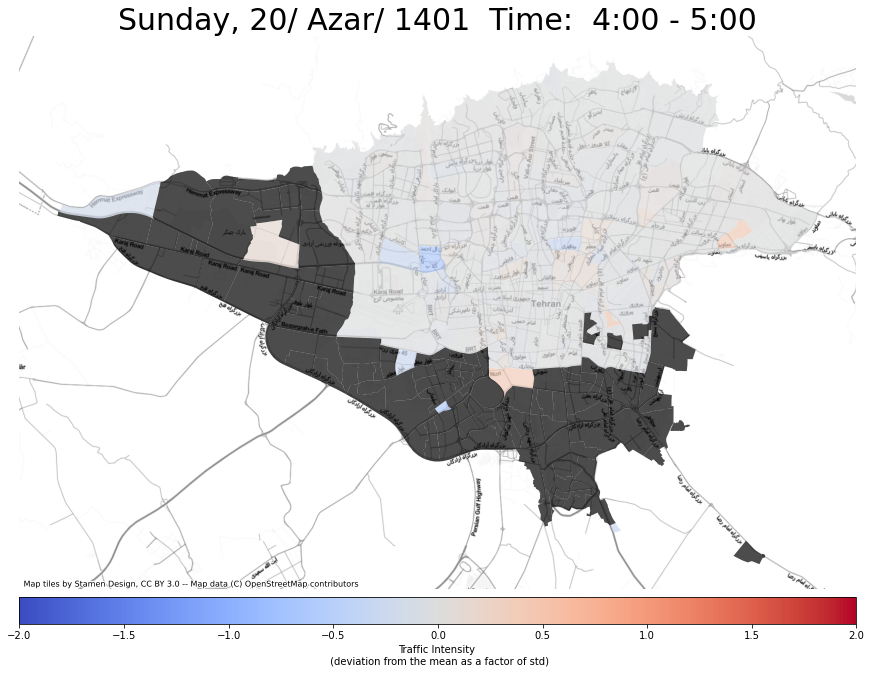

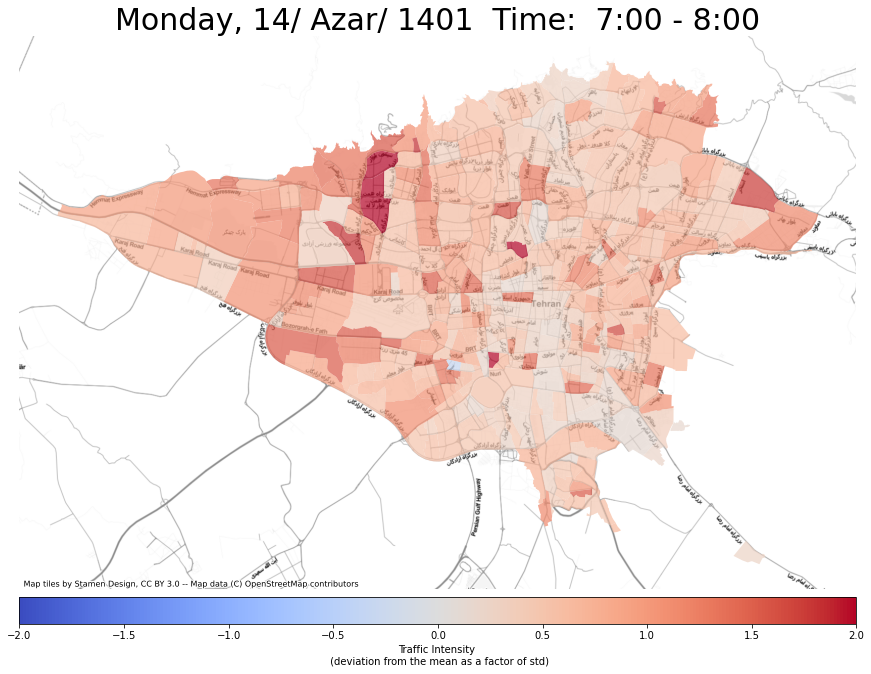

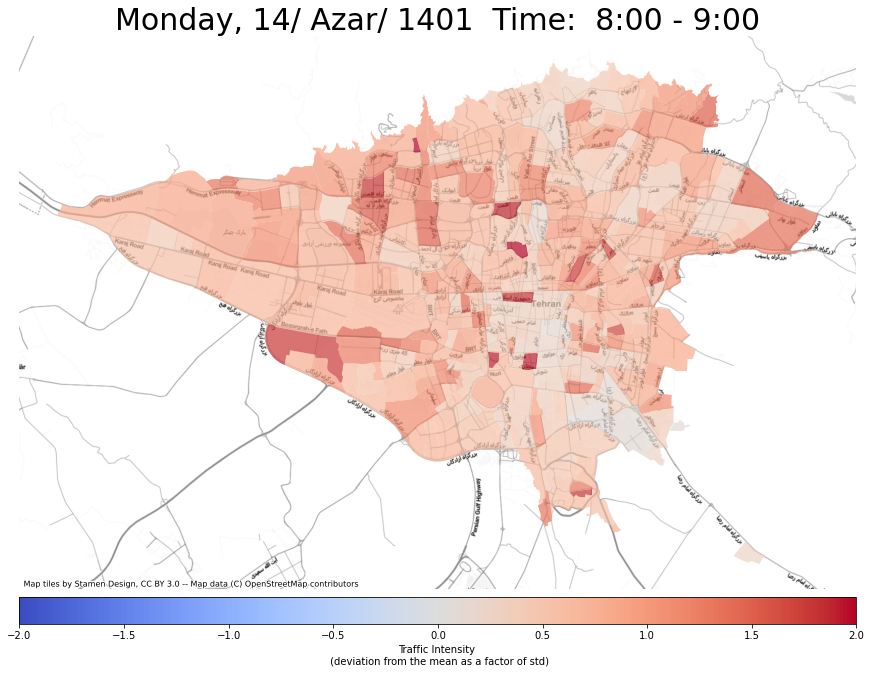

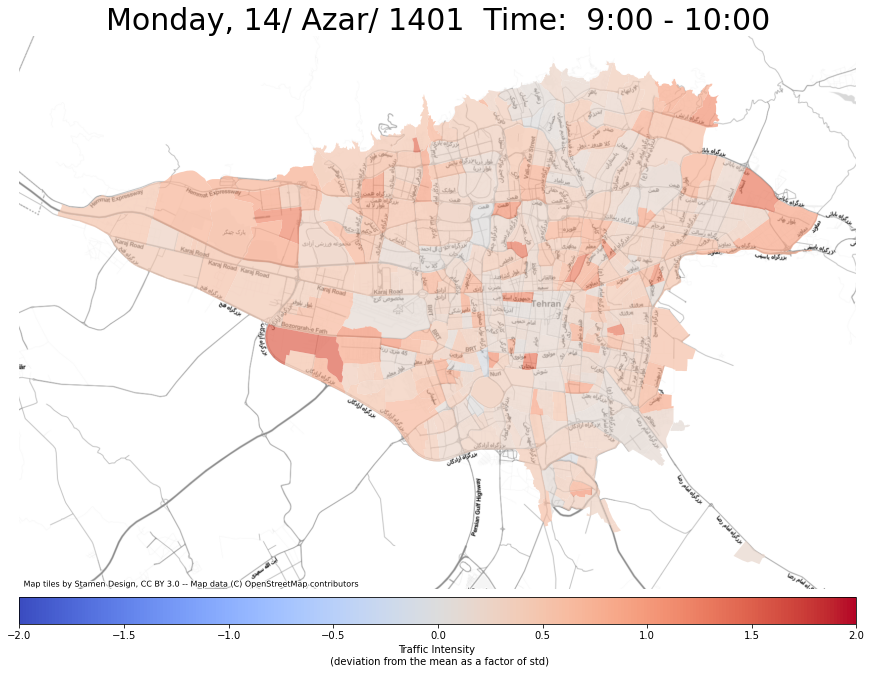

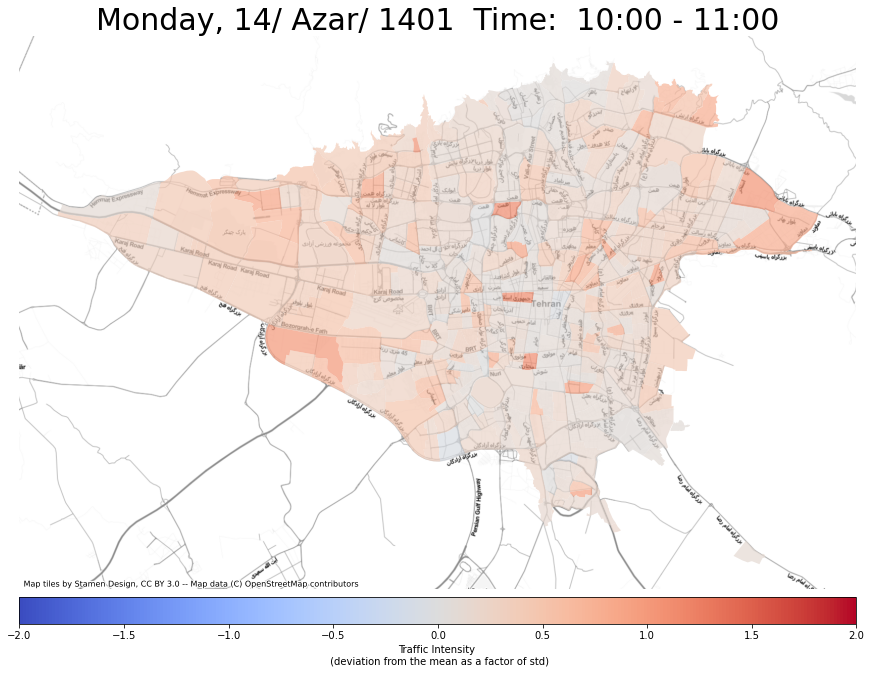

...

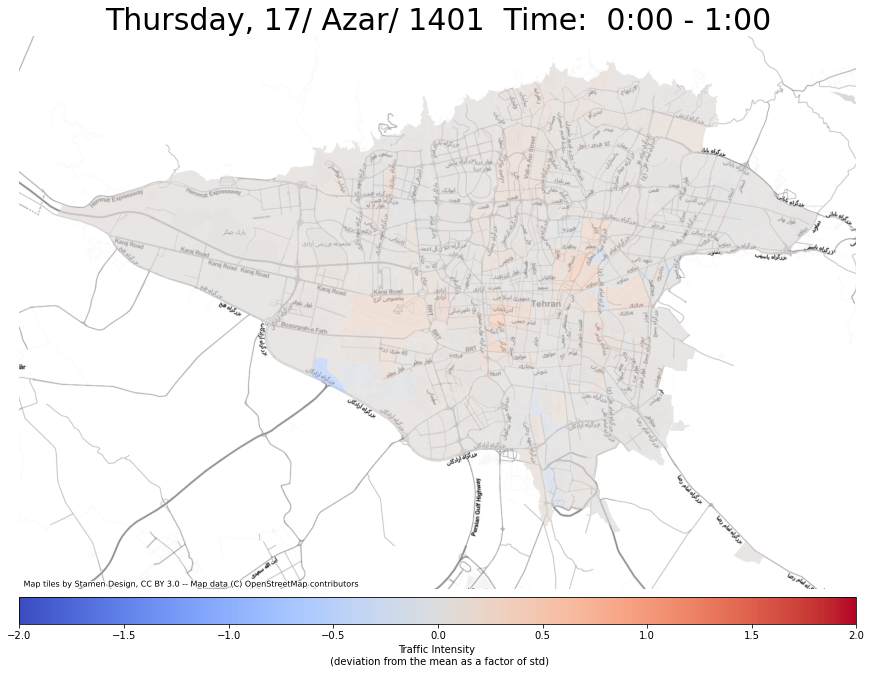

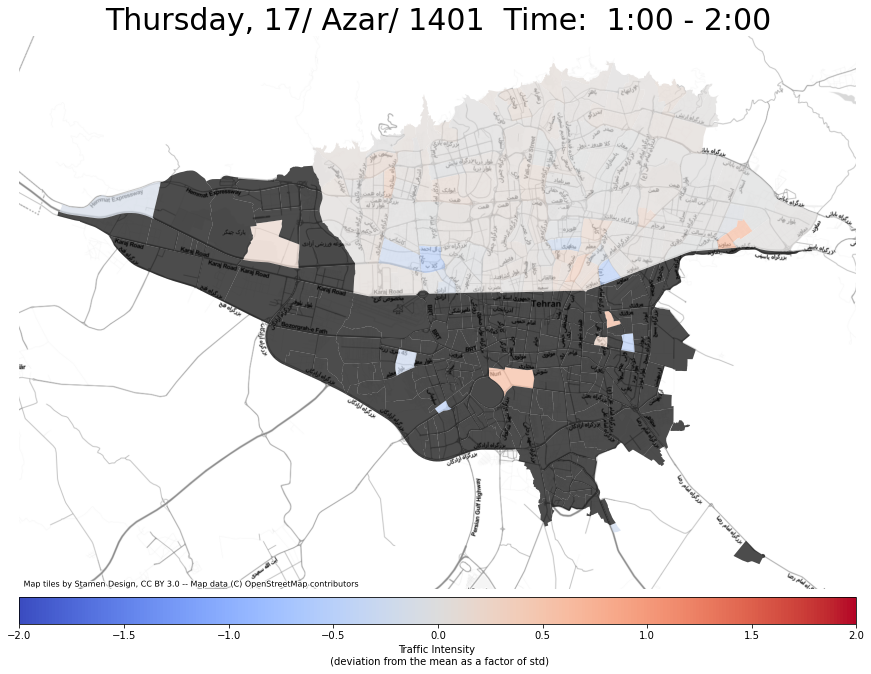

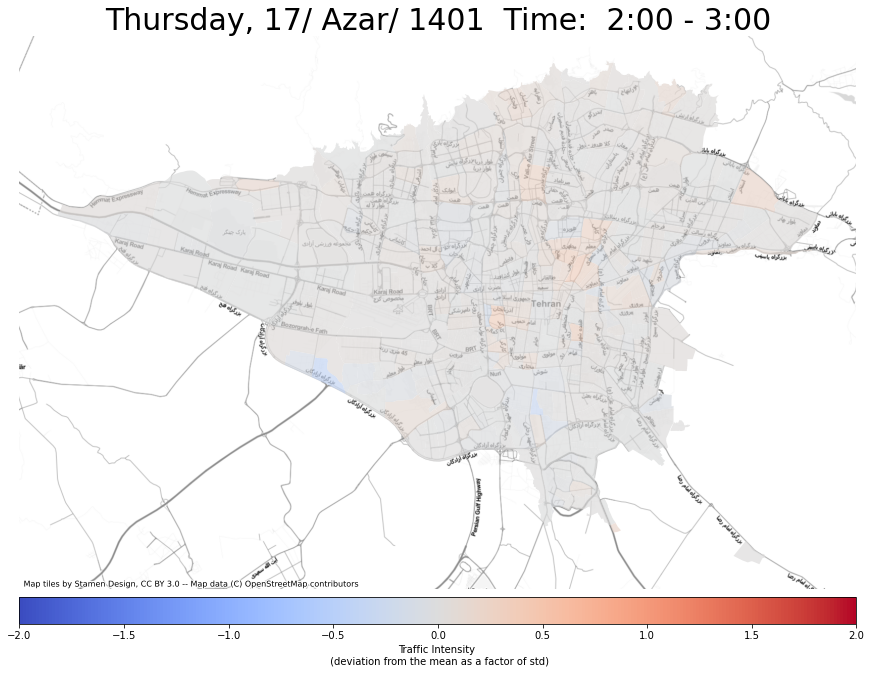

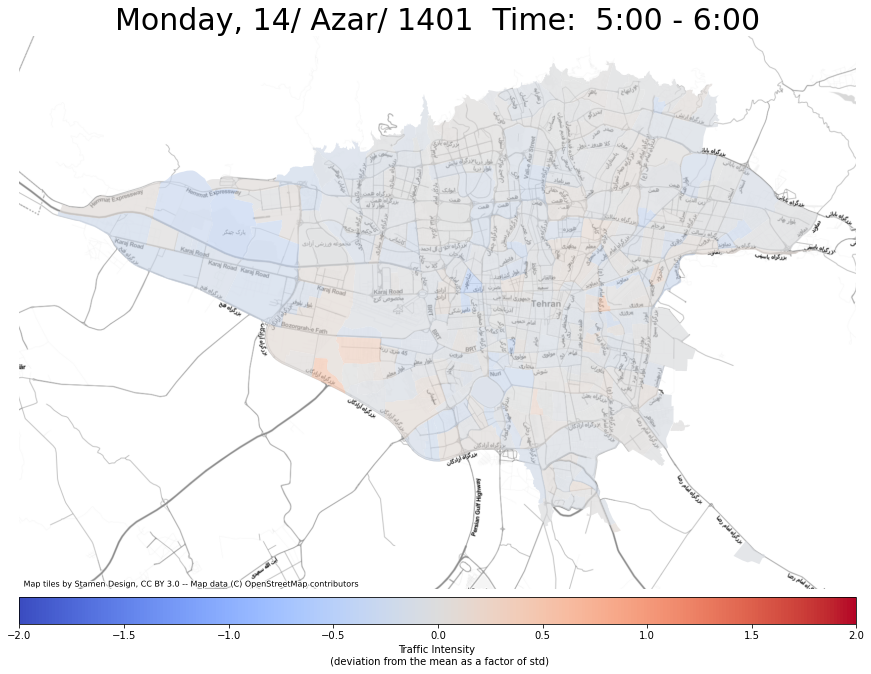

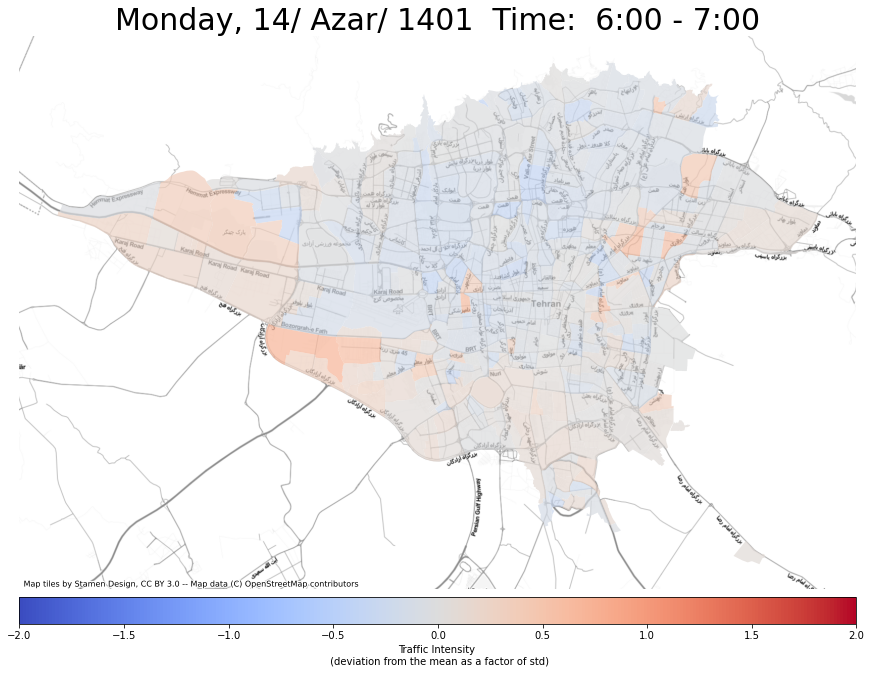

In [6]:
#plot all figures

shp_file = gpd.read_file('./regions_shapefiles/mahale.shp')
shp_file = shp_file.to_crs(epsg=3857)

benchmark_directory = './traffic_data/benchmark/'
treatment_group_directory = './traffic_data/protest_days/'
benchmark = create_benchmark_traffic(benchmark_directory, 'time_observed', 'NAME_MAHAL_orig')

for file in glob.glob(treatment_group_directory + "*.xlsx"):
    data = pd.read_excel(file)

    data = data.groupby('NAME_MAHAL_orig').agg({'duration_in_traffic':'mean','duration':'mean','time_observed':'first'})
    #############
    data['hour'] = [i.hour for i in data['time_observed']]
    data = data.merge(benchmark, how= 'left', on=['NAME_MAHAL_orig','hour']).reset_index()
    data['traffic_density'] = (data['duration_in_traffic']-data['duration_in_trafficmean']
                               )/data['duration_in_trafficstd']
    
    
    #############
    dmap = shp_file.merge(data, how= 'left', left_on='NAME_MAHAL', right_on='NAME_MAHAL_orig')
    
    plot_name = re.findall(r'\d+', file)[0]
    
    legend_kwds={'label': "Traffic Intensity \n (deviation from the mean as a factor of std)",
                            'orientation': "horizontal"}
    
    plot_tehran_nb(dmap, 'traffic_density', 'time_observed', './output/figures/' + plot_name + '.jpg', -2, 2, legend_kwds)



In [53]:
benchmark

,index,NAME_MAHAL_orig,hour,duration_in_trafficmean,duration_in_trafficstd,durationmean,time_observedfirst,relative_traffic
0,0,آبشار,0,1379.777778,531.677341,1802.333333,2022-12-12 00:48:57.989,0.765551
1,1,آبشار,1,1344.000000,519.856629,1788.055556,2022-12-12 01:48:59.270,0.751654
2,2,آبشار,2,1348.870370,524.447420,1813.851852,2022-12-12 02:49:00.805,0.743650
3,3,آبشار,3,1335.000000,516.732806,1803.074074,2022-12-12 03:49:01.770,0.740402
4,4,آبشار,4,1323.861111,517.673977,1854.944444,2022-12-11 04:48:14.004,0.713693
...,...,...,...,...,...,...,...,...
8155,8155,گلچين,19,1608.531250,1353.030576,1257.843750,2022-12-11 19:49:01.489,1.278801
8156,8156,گلچين,20,1313.218750,1065.009215,1211.312500,2022-12-11 20:49:04.166,1.084129
8157,8157,گلچين,21,1107.625000,874.083732,1218.406250,2022-12-11 21:49:06.274,0.909077
8158,8158,گلچين,22,979.562500,789.878428,1213.093750,2022-12-11 22:49:07.481,0.807491


In [7]:
files = [ './output/figures/' + file for file in os.listdir('./output/figures/') ]

#sort file numbers (so 1 digit names come before 2 digit names)
files = [file.replace('./output/figures2/', '') for file in files]
files = [file.replace('.jpg', '') for file in files]
files_int = [int(file) for file in files]
sorted_files = ['./output/figures/' + x +'.jpg' for _, x in sorted(zip(files_int, files))]


make_gif(sorted_files, './output/main.mp4', 2)

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (3631, 2803) to (3632, 2816) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).
